## Import packages

In [18]:
import osmnx as ox, networkx as nx, numpy as np, pandas as pd, geopandas as gpd, random, math
import matplotlib.pyplot as plt, matplotlib.colors as mcolors
from shapely.geometry import Point

from itertools import cycle
from pathlib import Path
from collections import defaultdict
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import MinMaxScaler
import folium
from folium import GeoJson, CircleMarker, Marker, PolyLine, Icon, DivIcon
from folium.plugins import MarkerCluster
from matplotlib.lines import Line2D
from math import ceil
from sklearn_extra.cluster import KMedoids
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import RobustScaler
import numpy as np
import matplotlib.pyplot as plt
import random
import math
import numpy as np
import pandas as pd
from ortools.constraint_solver import pywrapcp
from ortools.constraint_solver import routing_enums_pb2
from shapely.geometry import Point


## Load data

In [19]:
def load_data(nombre_archivo, directorio_base='../../../../data/delivetter'):
    """
    Carga un archivo GeoJSON específico y devuelve un GeoDataFrame.
    
    Args:
        nombre_archivo (str): Nombre del archivo GeoJSON (ej. 'barris.geojson').
        directorio_base (str): Ruta relativa al directorio donde se encuentra el archivo.
                              Por defecto: '../../data/delivetter'.
    
    Returns:
        gpd.GeoDataFrame: GeoDataFrame con los datos del archivo.
    """
    try:
        ruta = Path(directorio_base) / nombre_archivo
        
        if not ruta.exists():
            raise FileNotFoundError(f"File not found: {ruta.absolute()}")
        
        gdf = gpd.read_file(ruta)
        print(f"✅ '{nombre_archivo}' successfully loaded ({len(gdf)} records)")
        return gdf
    
    except Exception as e:
        print(f"❌ Error loading '{nombre_archivo}': {str(e)}")
    
barrios = load_data('barris.geojson')
catastro = load_data('catastro.geojson')
puntos_carga = load_data('puntosCID.geojson')

✅ 'barris.geojson' successfully loaded (75 records)
✅ 'catastro.geojson' successfully loaded (36346 records)
✅ 'puntosCID.geojson' successfully loaded (882 records)


## Graph request 

In [20]:
def get_graph(request):
    global barrio, G_drive, G_walk, shp_zone, shp_loading_points, shp_bajos

    shp_neighbourhood = barrios[barrios["nombre"].str.strip().str.upper() == request.strip().upper()]
    if len(shp_neighbourhood) != 1:
        shp_neighbourhood = barrios[barrios["nombre"].str.upper().str.contains(request.strip().upper())]
    while len(shp_neighbourhood) != 1:
        request = input("Please, introduce a valid neighbourhood: ")
        shp_neighbourhood = barrios[barrios["nombre"].str.strip().str.upper() == request.strip().upper()]
        if len(shp_neighbourhood) == 1:
            break
        shp_neighbourhood = barrios[barrios["nombre"].str.upper().str.contains(request.strip().upper())]

    barrio = shp_neighbourhood["nombre"].values[0]
    shp_zone = shp_neighbourhood.geometry.values[0]
    shp_loading_points = puntos_carga[puntos_carga.intersects(shp_zone)]
    shp_bajos = catastro[catastro.intersects(shp_zone)]

    G = ox.graph_from_polygon(
        shp_zone,
        network_type="all_public",
        simplify=False,
        retain_all=False,
        truncate_by_edge=True
    )

    not_highway = ['elevator', 'busway', 'corridor', 'unclassified', 'services', 'cycleway', 'steps', 'service']
    allowed_vehicle = ['motorway', 'residential', 'secondary', 'living_street', 'primary_link', 'primary', 'tertiary', 'trunk', 'service', 'tertiary_link', 'trunk_link', 'secondary_link', 'motorway_link', 'road']
    allowed_pedestrian = ['pedestrian', 'footway', 'path', 'track', 'bridleway', 'living_street', 'residential']

    edges_to_remove = [(u, v, k) for u, v, k, data in G.edges(keys=True, data=True)
                       if data.get('highway') in not_highway or data.get('access') in ['private', 'no', 'customers']]
    G.remove_edges_from(edges_to_remove)

    G_vehicle = G.copy()
    G_pedestrian = G.copy()

    edges_to_remove_vehicle = [(u, v, k) for u, v, k, data in G_vehicle.edges(keys=True, data=True)
                                if data.get('highway') not in allowed_vehicle]
    G_vehicle.remove_edges_from(edges_to_remove_vehicle)

    edges_to_remove_pedestrian = [(u, v, k) for u, v, k, data in G_pedestrian.edges(keys=True, data=True)
                                  if data.get('highway') not in allowed_pedestrian]
    G_pedestrian.remove_edges_from(edges_to_remove_pedestrian)

    for graph in [G_vehicle, G_pedestrian]:
        nodes_to_remove = [node for node in graph.nodes if graph.degree(node) == 0]
        graph.remove_nodes_from(nodes_to_remove)

    G_drive = G_vehicle.subgraph(max(nx.weakly_connected_components(G_vehicle), key=len)).copy()
    G_walk = G_pedestrian.subgraph(max(nx.weakly_connected_components(G_pedestrian), key=len)).copy()


def graph_map():
    print(f"Graph for {barrio}:")
    print(f"Vehicle graph: {len(G_drive.nodes)} nodes, {len(G_drive.edges)} edges")
    print(f"Pedestrian graph: {len(G_walk.nodes)} nodes, {len(G_walk.edges)} edges")
    print(f"Loading points: {len(shp_loading_points)} points")
    print(f"Warehouse and store: {len(shp_bajos)} points")
    
    # --- 1. Visualización de grafos en matplotlib ---
    fig, axes = plt.subplots(1, 2, figsize=(20, 8))
    axes[0].set_aspect('equal', 'box')
    axes[1].set_aspect('equal', 'box')
    ox.plot_graph(G_drive, ax=axes[0], node_size=3, node_color='green', 
                  edge_linewidth=0.5, edge_color='blue', bgcolor="white", show=False)
    axes[0].set_title("Drive graph")

    ox.plot_graph(G_walk, ax=axes[1], node_size=3, node_color='green', 
                  edge_linewidth=0.5, edge_color='red', bgcolor="white", show=False)
    axes[1].set_title("Pedestrian graph")
    plt.tight_layout()
    plt.show()

    # --- 2. Mapa interactivo en Folium ---
    mapa = folium.Map(location=[shp_zone.centroid.y, shp_zone.centroid.x], zoom_start=16)

    gdf_edges_vehicle = ox.graph_to_gdfs(G_drive, nodes=False, edges=True)
    gdf_edges_pedestrian = ox.graph_to_gdfs(G_walk, nodes=False, edges=True)

    bajos_in_zone = shp_bajos[shp_bajos.intersects(shp_zone)]

    # --- 2.1 Crear capas para aristas, puntos de carga y bajos ---
    # Crear FeatureGroups para cada tipo de capa
    barrio_group = folium.FeatureGroup(name="Neighborhood Boundary")
    edge_group_vehicle = folium.FeatureGroup(name="Vehicle Edges")
    edge_group_pedestrian = folium.FeatureGroup(name="Pedestrian Edges")
    loading_points_group = folium.FeatureGroup(name="Loading Points")
    bajos_group = folium.FeatureGroup(name="Warehouse & Store")

    # --- 2.2 Añadir zona del barrio ---
    folium.GeoJson(
        shp_zone,
        style_function=lambda feature: {
            "color": "limegreen", "weight": 4, "fill": True,
            "fillColor": "limegreen", "fillOpacity": 0.1
        }
    ).add_to(barrio_group)

   

    # --- 2.3 Función para añadir aristas a las capas ---
    def add_edges(gdf_edges, color, group_name, group):
        for _, row in gdf_edges.iterrows():
            if row.geometry.geom_type == "LineString":
                tooltip = folium.Tooltip(
                    f"<b>Type:</b> {row.get('highway', 'N/A')}<br>"
                    f"<b>Name:</b> {row.get('name', 'No name')}<br>"
                    f"<b>Length:</b> {round(row.get('length', 0), 1)} m"
                )
                folium.GeoJson(
                    row.geometry,
                    name=group_name,
                    style_function=lambda feature, col=color: {'color': col, 'weight': 2, 'opacity': 1},
                    tooltip=tooltip
                ).add_to(group)

    # Añadir aristas a las capas correspondientes
    add_edges(gdf_edges_pedestrian, "red", "Pedestrians", edge_group_pedestrian)
    add_edges(gdf_edges_vehicle, "blue", "Vehicles", edge_group_vehicle)

    # --- 2.4 Añadir puntos de carga a la capa ---
    for _, row in shp_loading_points.iterrows():
        folium.CircleMarker(
            location=[row.geometry.centroid.y, row.geometry.centroid.x],
            radius=6, color="black", fill=True, fill_color="orange", fill_opacity=1,
            popup=row.get("NOMBRE", "Loading Point")
        ).add_to(loading_points_group)

    # --- 2.5 Añadir puntos bajos (almacenes y comercios) a la capa ---
    for _, row in bajos_in_zone.iterrows():
        if not row['Almacen'] and not row['Comercio']:
            continue
        centroide = row.geometry.centroid
        if row['Almacen'] and row['Comercio']:
            fill_color, label = 'black', 'Warehouse & Store'
        elif row['Almacen']:
            fill_color, label = 'purple', 'Warehouse'
        else:
            fill_color, label = 'lightblue', 'Store'
        folium.CircleMarker(
            location=[centroide.y, centroide.x],
            radius=6, color='black', fill=True, fill_color=fill_color, fill_opacity=1,
            popup=label
        ).add_to(bajos_group)

    # --- 2.6 Añadir leyenda personalizada ---
    legend_html = '''
    <div style="position: fixed; bottom: 50px; left: 50px; width: 250px; height: 140px;
                background-color: white; z-index:9999; font-size:13px; border:1px solid grey; 
                border-radius: 5px; padding: 8px; box-shadow: 2px 2px 5px rgba(0,0,0,0.2);">
        <b style="font-size:14px;">Legend</b><br>
        <i class="fa fa-circle" style="color:black; margin-right:5px;"></i> Warehouse & Store<br>
        <i class="fa fa-circle" style="color:orange; margin-right:5px;"></i> CiD Point<br>
        <i class="fa fa-circle" style="color:purple; margin-right:5px;"></i> Warehouse<br>
        <i class="fa fa-circle" style="color:lightblue; margin-right:5px;"></i> Store (delivery)<br>
        <i class="fa fa-square" style="color:limegreen; margin-right:5px;"></i> Neighborhood Boundary
    </div>'''
    mapa.get_root().html.add_child(folium.Element(legend_html))

    # --- 2.7 Añadir las capas al mapa ---
    barrio_group.add_to(mapa)
    edge_group_vehicle.add_to(mapa)
    edge_group_pedestrian.add_to(mapa)
    loading_points_group.add_to(mapa)
    bajos_group.add_to(mapa)

    # --- 2.8 Añadir control de capas ---
    folium.LayerControl(collapsed=False).add_to(mapa)

    return mapa

### 🏙️ NEIGHBORHOODS WITH AT LEAST ONE CiD POINT

| AIORA                | ARRANCAPINS          | BENICALAP               | BENIFERRI                |
|----------------------|----------------------|--------------------------|--------------------------|
| BENIFARAIG           | BENIMACLET           | BENIMAMET               | CABANYAL-CANYAMELAR      |
| CAMI DE VERA         | CAMI FONDO           | CAMI REAL               | CAMPANAR                 |
| CASTELLAR-L'OLIVERAL | CIUTAT DE LES ARTS I DE LES CIENCIES | CIUTAT FALLERA | CIUTAT JARDI             |
| CIUTAT UNIVERSITARIA | EL BOTANIC           | EL CALVARI              | EL FORN D'ALCEDO         |
| EL GRAU              | EL MERCAT            | EL PALMAR               | EL PERELLONET            |
| EL PLA DEL REMEI     | EN CORTS             | EXPOSICIO               | FAVARA                   |
| JAUME ROIG           | LA CARRASCA          | LA CREU COBERTA         | LA CREU DEL GRAU         |
| LA FONTETA S.LLUIS   | LA FONTSANTA         | LA GRAN VIA             | LA LLUM                  |
| LA MALVA-ROSA        | LA PETXINA           | LA PUNTA                | LA RAIOSA                |
| LA ROQUETA           | LA SEU               | LA TORRE                | LA VEGA BAIXA            |
| LES TENDETES         | L'HORT DE SENABRE    | L'ILLA PERDUDA          | L'AMISTAT                |
| MALILLA              | MARXALENES           | MASSARROJOS             | MESTALLA                 |
| MONTOLIVET           | MORVEDRE             | NATZARET                | NOU MOLES                |
| PATRAIX              | PENYA-ROJA           | PINEDO                  | RUSSAFA                  |
| SAFRANAR             | SANT ANTONI          | SANT FRANCESC           | SANT ISIDRE              |
| SANT LLORENS         | SANT MARCEL.LI       | SANT PAU                | SOTERNES                 |
| TORMOS               | TORREFIEL            | TRINITAT                | TRES FORQUES             |
| VARA DE QUART        | ALBORS               | BETERO                  |                          |



Graph for AIORA:
Vehicle graph: 448 nodes, 511 edges
Pedestrian graph: 1083 nodes, 2241 edges
Loading points: 28 points
Warehouse and store: 680 points


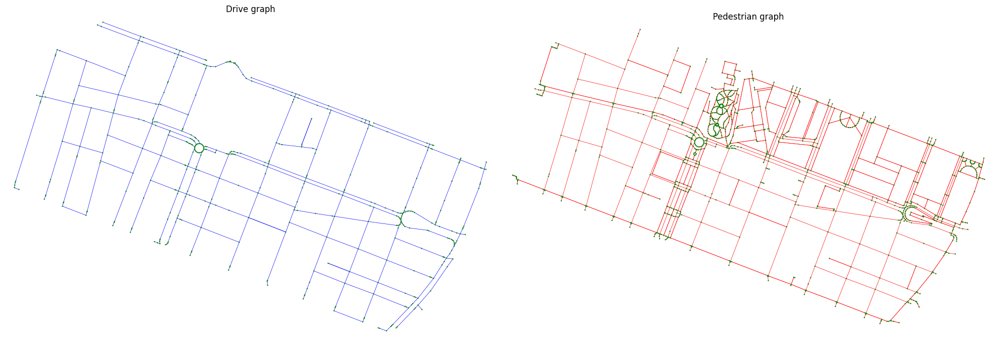

In [21]:
get_graph('AIORA')
graph_map()

## Supergraph building

✅ Supergraph AIORA created: 1602 nodes, 3818 edges.


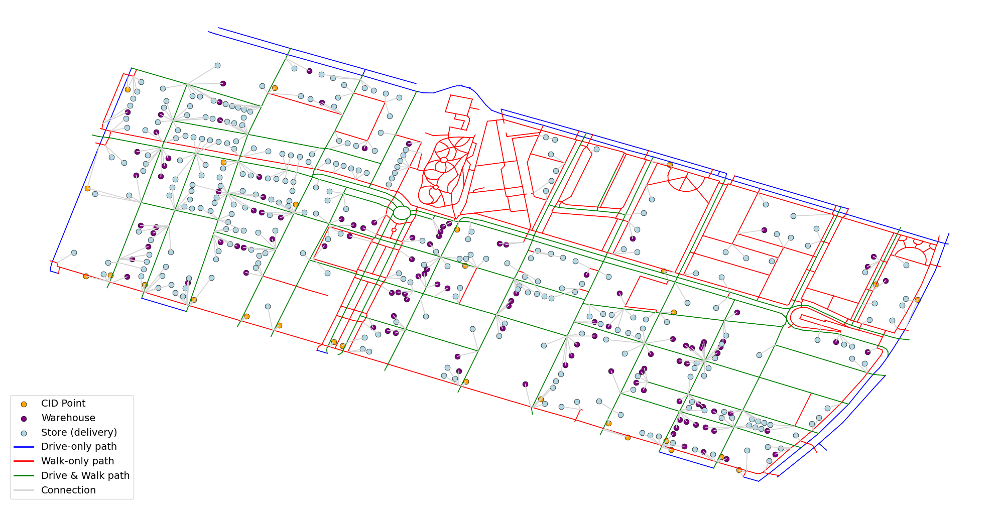

In [22]:
def build_supergraph(VELOCIDAD_PEATON=5, VELOCIDAD_VEHICULO=35, VELOCIDAD_CONEXION=10):

    # 1) Crear supergrafo vacío
    G_super = nx.MultiDiGraph()
    G_super.add_nodes_from(G_drive.nodes(data=True))  # Usamos G_drive
    G_super.add_nodes_from(G_walk.nodes(data=True))  # Usamos G_walk

    # 2) Función para fusionar aristas
    def add_or_merge_edge(G, u, v, key, data, mode):
        global G_super  # Declaramos que modificamos la variable global
        data = data.copy()
        modos = data.get('mode', [])
        if not isinstance(modos, list): modos = [modos]
        if mode not in modos: modos.append(mode)
        data['mode'] = modos
        if G.has_edge(u, v):
            for k_exist, existing in G[u][v].items():
                if existing.get('geometry') == data.get('geometry'):
                    exist_mod = existing.get('mode', [])
                    if not isinstance(exist_mod, list): exist_mod = [exist_mod]
                    for m in modos:
                        if m not in exist_mod: exist_mod.append(m)
                    existing['mode'] = exist_mod
                    return
        G.add_edge(u, v, key=key, **data)

    # Añadir aristas de drive y walk
    for u, v, k, data in G_drive.edges(keys=True, data=True):  # Usamos G_drive
        add_or_merge_edge(G_super, u, v, k, data, 'drive')
        if not data.get('oneway', True) or data.get('reversed', False):
            add_or_merge_edge(G_super, v, u, k, data, 'drive')
        elif not G_drive.has_edge(v, u):
            data['fake'] = True
            add_or_merge_edge(G_super, v, u, k, data, 'drive')
            
    for u, v, k, data in G_walk.edges(keys=True, data=True):  # Usamos G_walk
        add_or_merge_edge(G_super, u, v, k, data, 'walk')
        if not G_walk.has_edge(v, u):
            add_or_merge_edge(G_super, v, u, k, data, 'walk')

    # 3) Haversine helper
    def haversine(coord1, coord2):
        global G_super  # Declaramos que modificamos la variable global
        lon1, lat1, lon2, lat2 = map(math.radians, [*coord1, *coord2])
        dlat, dlon = lat2-lat1, lon2-lon1
        a = math.sin(dlat/2)**2 + math.cos(lat1)*math.cos(lat2)*math.sin(dlon/2)**2
        return 2*math.asin(math.sqrt(a))*6371000

    # 4) Función para añadir nodo especial
    def add_special_node(G, geom, tipo, idx):
        global G_super  # Declaramos que modificamos la variable global
        nid = f"{tipo}_{idx}"
        lon, lat = geom.centroid.x, geom.centroid.y
        G.add_node(nid, x=lon, y=lat, tipo=tipo)
        conexiones = []
        if tipo == 'carga':
            nd = ox.distance.nearest_nodes(G_drive, lon, lat)  # Usamos G_drive
            conexiones.append((nd, 'drive', haversine((lon,lat), (G_drive.nodes[nd]['x'], G_drive.nodes[nd]['y']))))
            nw = ox.distance.nearest_nodes(G_walk, lon, lat)  # Usamos G_walk
            conexiones.append((nw, 'walk', haversine((lon,lat), (G_walk.nodes[nw]['x'], G_walk.nodes[nw]['y']))))
        else:
            nw = ox.distance.nearest_nodes(G_walk, lon, lat)  # Usamos G_walk
            conexiones.append((nw, 'walk', haversine((lon,lat), (G_walk.nodes[nw]['x'], G_walk.nodes[nw]['y']))))
        for vec, modo, dist in conexiones:
            G.add_edge(nid, vec, mode=['connection', modo], length=dist)
            G.add_edge(vec, nid, mode=['connection', modo], length=dist)
        return nid

    nodos_carga = [add_special_node(G_super, row.geometry, 'carga', i)
                   for i, row in shp_loading_points.iterrows()]
    nodos_comercios = [add_special_node(G_super, row.geometry, 'comercio', i)
                       for i, row in shp_bajos[shp_bajos['Comercio']].iterrows()]
    nodos_almacenes = [add_special_node(G_super, row.geometry, 'almacen', i)
                       for i, row in shp_bajos[shp_bajos['Almacen']].iterrows()]

    # 5) Añadir tiempos a aristas
    def calcular_tiempos_en_aristas(G, v_w=5, v_v=35, v_c=10):
        global G_super  # Declaramos que modificamos la variable global
        def tpd(dist, vel): return dist/(vel*1000/60)
        v_peat = np.random.normal(v_w,0.2*v_w,30)
        v_conn = np.random.normal(v_c,0.2*v_c,30)
        v_veh  = np.random.normal(v_v,0.2*v_v,30)
        for u,v,k,data in G.edges(keys=True, data=True):
            penalty = 1
            if 'fake' in data:
                penalty = 5
            d = data.get('length',0)
            modos = data.get('mode',[])
            if 'connection' in modos:
                data['tiempo_walk']  = penalty * tpd(d, np.random.choice(v_peat))
                data['tiempo_drive'] = penalty * tpd(d, np.random.choice(v_conn))
                continue
            if 'walk' in modos:
                data['tiempo_walk']  = penalty * tpd(d, np.random.choice(v_peat))
            if 'drive' in modos:
                vmax = data.get('maxspeed', np.random.choice(v_veh))
                if isinstance(vmax, str):
                    vmax = int(''.join(filter(str.isdigit, vmax)) or 30)
                vkh = max(vmax*0.5, np.random.normal(vmax*0.8, vmax*0.1))
                data['tiempo_drive'] = penalty * tpd(d, vkh)
            data.setdefault('tiempo_walk', float('inf'))
            data.setdefault('tiempo_drive', float('inf'))

    calcular_tiempos_en_aristas(G_super, VELOCIDAD_PEATON, VELOCIDAD_VEHICULO, VELOCIDAD_CONEXION)

    print(f"✅ Supergraph {barrio} created: {len(G_super.nodes)} nodes, {len(G_super.edges)} edges.")
    return G_super, nodos_carga, nodos_comercios, nodos_almacenes

def view_super(G_super):
    # 1) Configuración de figura
    fig, ax = plt.subplots(figsize=(20, 20))
    ax.set_aspect('equal', 'box')
    ax.axis('off')

    # 2) Colores para modos de arista
    edge_colors = {
        'drive': 'blue',
        'walk': 'red',
        'drive+walk': 'green',
        'connection': 'lightgray'
    }
    edges_by_mode = {mode: [] for mode in edge_colors}

    # 3) Agrupar segmentos por modo
    for u, v, data in G_super.edges(data=True):
        modos = data.get('mode', [])
        if isinstance(modos, list):
            if 'connection' in modos:
                key = 'connection'
            elif 'drive' in modos and 'walk' in modos:
                key = 'drive+walk'
            elif 'drive' in modos:
                key = 'drive'
            elif 'walk' in modos:
                key = 'walk'
            else:
                key = 'connection'
        else:
            key = modos if modos in edge_colors else 'connection'

        x0, y0 = G_super.nodes[u]['x'], G_super.nodes[u]['y']
        x1, y1 = G_super.nodes[v]['x'], G_super.nodes[v]['y']
        edges_by_mode[key].append(((x0, x1), (y0, y1)))

    # 4) Dibujar aristas
    for mode, segments in edges_by_mode.items():
        for xs, ys in segments:
            ax.plot(xs, ys, color=edge_colors[mode], linewidth=1)

    # 5) Definir categorías de nodos
    categorias = {
        'cid':               {'coords': [], 'color': 'orange',     'label': 'CID Point'},
        'almacen_m3':        {'coords': [], 'color': 'purple',     'label': 'Warehouse'},
        'comercio_entrega':  {'coords': [], 'color': 'lightblue', 'label': 'Store (delivery)'},
        'almacen_y_comercio':{'coords': [], 'color': 'black',     'label': 'Warehouse & Shop'}
    }

    # 6) Recolectar coordenadas
    for nodo, data in G_super.nodes(data=True):
        tipo = data.get('tipo')
        coord = (data['x'], data['y'])
        if tipo == 'carga':
            categorias['cid']['coords'].append(coord)
        elif tipo == 'almacen' and 'comercio' in nodo:
            categorias['almacen_y_comercio']['coords'].append(coord)
        elif tipo == 'almacen':
            categorias['almacen_m3']['coords'].append(coord)
        elif tipo == 'comercio':
            categorias['comercio_entrega']['coords'].append(coord)

    # 7) Dibujar nodos
    for cat in categorias.values():
        if cat['coords']:
            xs, ys = zip(*cat['coords'])
            ax.scatter(xs, ys, color=cat['color'], s=60,
                       edgecolor='k', linewidth=0.5, label=cat['label'])

    # 8) Leyenda de aristas
    edge_legend = [
        Line2D([0], [0], color=edge_colors[m], lw=2, label=label)
        for m, label in [
            ('drive', 'Drive-only path'),
            ('walk', 'Walk-only path'),
            ('drive+walk', 'Drive & Walk path'),
            ('connection', 'Connection')
        ]
    ]

    # 9) Combinar leyendas y mostrar
    handles_nodes, labels_nodes = ax.get_legend_handles_labels()
    handles = handles_nodes + edge_legend
    labels  = labels_nodes + [l.get_label() for l in edge_legend]
    by_label = dict(zip(labels, handles))
    ax.legend(by_label.values(), by_label.keys(),
              loc='lower left', fontsize=14)

    plt.tight_layout()
    plt.show()


# Después de llamar a build_supergraph
G_super, nodos_carga, nodos_comercios, nodos_almacenes = build_supergraph()
view_super(G_super)


## M2 Pipeline

### 1º Deliveries sample

In [ ]:
N_PAQUETES = 300               # Número total de paquetes a repartir
PAQUETES_MIN = 1               # Mínimo de paquetes por comercio
PAQUETES_MAX = 5               # Máximo de paquetes por comercio
CAPACIDAD_MAXIMA_WALK = 8      # Capacidad máxima que puede cargar el repartidor
CAPACIDAD_MAXIMA_ONA = 20      # Capacidad máxima que puede cargar el robot


def generate_comercios_df(nodos_comercios,
                          N_PAQUETES=50,
                          PAQUETES_MIN=1,
                          PAQUETES_MAX=5,
                          CAPACIDAD_MAXIMA=8):
    """
    Selecciona comercios aleatorios y reparte paquetes sobre ellos.

    Args:
      nodos_comercios (list): lista de IDs de nodo “comercio” en G_super (variable global).
      N_paquetes      (int): total de paquetes a repartir.
      paquetes_min    (int): mínimo paquetes por comercio.
      paquetes_max    (int): máximo paquetes por comercio.
      capacidad_maxima(int): Q, capacidad máxima por viaje.

    Devuelve:
      GeoDataFrame con columnas ['node','paquetes','geometry'].
    """
    if PAQUETES_MAX < PAQUETES_MIN or PAQUETES_MIN < 0 or PAQUETES_MAX < 0 or CAPACIDAD_MAXIMA < 0 or CAPACIDAD_MAXIMA < min(PAQUETES_MIN, PAQUETES_MAX):
        raise ValueError("Invalid values for constants. Check the input values.")

    # Verificar que el número de paquetes no exceda la capacidad total
    if len(nodos_comercios)*(PAQUETES_MAX+PAQUETES_MIN)/3 < N_PAQUETES:
        N_PAQUETES = int(len(nodos_comercios)*(PAQUETES_MAX+PAQUETES_MIN)/4)

    # Inicializar el diccionario para gestionar la capacidad restante de cada comercio
    comercios = {nodo: CAPACIDAD_MAXIMA for nodo in nodos_comercios}
    seleccionados = []
    pesos = []

    paquetes_asignados = 0
    n_paq = N_PAQUETES
    while paquetes_asignados < N_PAQUETES:
        restante = N_PAQUETES - paquetes_asignados
        max_pos = min(PAQUETES_MAX, restante)
        if max_pos < PAQUETES_MIN:
            break

        nodo = random.choice(nodos_comercios)
        capacidad_restante = comercios[nodo]

        # Verificar si el comercio tiene capacidad suficiente
        if capacidad_restante < PAQUETES_MIN:
            continue

        # Determinar cuántos paquetes asignar al comercio
        paquetes_a_asignar = random.randint(PAQUETES_MIN, min(max_pos, capacidad_restante))
        
        # Asignar los paquetes
        seleccionados.append(nodo)
        pesos.append(paquetes_a_asignar)

        # Actualizar la capacidad restante del comercio
        comercios[nodo] -= paquetes_a_asignar

        paquetes_asignados += paquetes_a_asignar

    # Agrupar por nodo y montar GeoDataFrame
    data = []
    for nodo in set(seleccionados):
        total = sum(p for n, p in zip(seleccionados, pesos) if n == nodo)
        lon = G_super.nodes[nodo]['x']
        lat = G_super.nodes[nodo]['y']
        data.append({
            'node': nodo,
            'paquetes': total,
            'geometry': Point(lon, lat)
        })

    return n_paq, gpd.GeoDataFrame(data, crs="EPSG:4326")

paq, df_comercios = generate_comercios_df(nodos_comercios,
                                     N_PAQUETES=N_PAQUETES,
                                     PAQUETES_MIN=PAQUETES_MIN,
                                     PAQUETES_MAX= PAQUETES_MAX,
                                     CAPACIDAD_MAXIMA=CAPACIDAD_MAXIMA_WALK)
display(df_comercios)


,node,paquetes,geometry
0,comercio_29578,1,POINT (-0.35024 39.46541)
1,comercio_29837,3,POINT (-0.34803 39.46593)
2,comercio_29751,7,POINT (-0.34915 39.46845)
3,comercio_30281,2,POINT (-0.34506 39.46851)
4,comercio_30280,4,POINT (-0.3453 39.46858)
...,...,...,...
79,comercio_30396,4,POINT (-0.34421 39.46377)
80,comercio_30091,3,POINT (-0.3468 39.46747)
81,comercio_31008,2,POINT (-0.33988 39.46376)
82,comercio_30982,6,POINT (-0.33936 39.463)


### 2º HUB SELECTION

In [24]:
def seleccionar_hub(nodos_almacenes, percentil=25):
    """
    Selecciona un hub de almacén basado en la proximidad al centroide del grafo.

    Parámetros:
    - nodos_almacenes: Lista de nodos que representan almacenes.
    - percentil: Percentil de almacenes más cercanos al centroide a considerar (por defecto 25).

    Retorna:
    - hub: Nodo seleccionado como hub.
    """
    
    # 2. Calcular el centroide del grafo (media de todas las coordenadas de nodos)
    xs = [data['x'] for _, data in G_super.nodes(data=True)]
    ys = [data['y'] for _, data in G_super.nodes(data=True)]
    centroide = Point(np.mean(xs), np.mean(ys))

    # 3. Medir la distancia euclídea de cada almacén al centroide
    distancias = []
    for n in nodos_almacenes:
        pt = Point(G_super.nodes[n]['x'], G_super.nodes[n]['y'])
        dist = centroide.distance(pt)
        distancias.append((n, dist))

    # 4. Tomar el percentil de almacenes más cercanos
    CANDIDATOS = ceil(len(nodos_almacenes) * (percentil / 100))
    candidatos = sorted(distancias, key=lambda x: x[1])[:CANDIDATOS]
    almacenes_cercanos = [n for n, _ in candidatos]

    # 5. Elegir uno al azar
    hub = random.choice(almacenes_cercanos)

    return hub

hub = seleccionar_hub(nodos_almacenes)
print(f"Hub selected: {hub}")

Hub selected: almacen_30525


### 3º Clustering

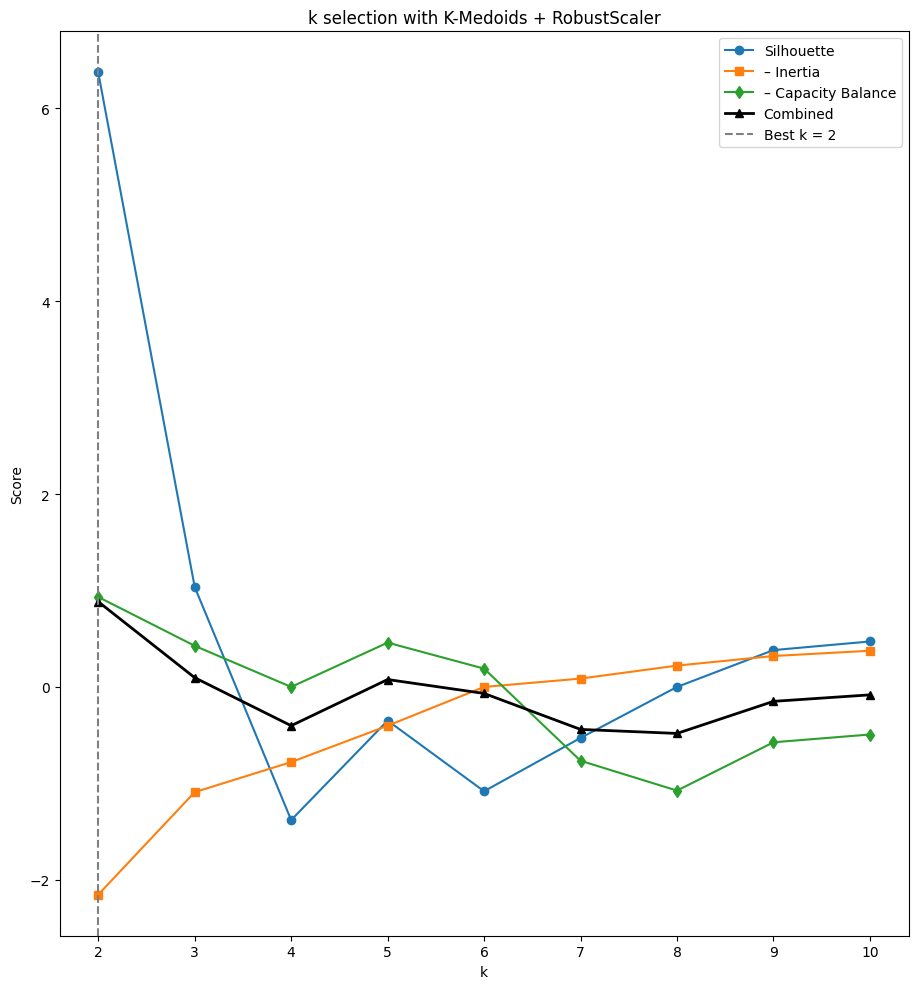

✅ Deliveries assigned to 2 robots (K-Medoids + hub-balanced).


In [25]:

K_MIN   = 2
K_MAX   = 10
ALPHA   = 0.15  # peso Silhouette
BETA    = 0.25  # peso Inertia
GAMMA   = 0.5  # peso Balance de capacidad

def clustering(df_comercios, hub, cap_max=CAPACIDAD_MAXIMA_ONA, k_min=2, k_max=10, alpha=0.15, beta=0.25, gamma=0.5, view=True):
    """
    Clustering de los comercios usando K-Medoids, evaluando el mejor número de clústeres con el
    método combinado de Silhouette, Inertia, y Balance de Capacidad, con ponderaciones.

    Args:
      df_comercios    : DataFrame con ['node', 'paquetes', 'geometry', 'grupo_repartidor'].
      hub             : Nodo del hub, para calcular la distancia de balance de capacidad.
      cap_max         : Capacidad máxima de la ruta para el balance.
      k_min           : Número mínimo de clústeres.
      k_max           : Número máximo de clústeres.
      alpha           : Peso del índice Silhouette.
      beta            : Peso de la Inertia.
      gamma           : Peso del balance de capacidad.

    Returns:
      best_k          : El mejor número de clústeres encontrado.
    """
    # 1) Extraemos las coordenadas y demandas
    coords = np.vstack([df_comercios.geometry.x.values, df_comercios.geometry.y.values]).T
    hub_coord = (G_super.nodes[hub]['x'], G_super.nodes[hub]['y'])
    demands = df_comercios['paquetes'].to_numpy()

    ks, sils, ines, balances = [], [], [], []
    hub_x, hub_y = hub_coord

    for k in range(k_min, min(k_max + 1, len(df_comercios))):
        # 2) Entrenamos K-Medoids
        kmed = KMedoids(n_clusters=k, init='k-medoids++', method='pam', metric='euclidean', random_state=33)
        labels = kmed.fit_predict(coords)

        # 3) Calculamos el índice de Silhouette
        sil = silhouette_score(coords, labels) if k > 1 else 0

        # 4) Calculamos la Inertia manualmente usando las posiciones de los medoids
        medoids = coords[kmed.medoid_indices_]
        inertia = sum(np.sum((coords[labels == j] - medoids[j]) ** 2) for j in range(k))

        # 5) Balance de capacidad, ponderado por la distancia del centroide al hub
        loads = np.array([demands[labels == j].sum() for j in range(k)])
        mults = np.ceil(loads / cap_max) * cap_max
        errors = (loads - mults) ** 2

        # Calculamos los centroides de cada clúster en el espacio geográfico
        balances_k = []
        for j in range(k):
            pts = coords[labels == j]
            centroid_x = np.mean(pts[:, 0])
            centroid_y = np.mean(pts[:, 1])
            distance_to_hub = np.sqrt((centroid_x - hub_x) ** 2 + (centroid_y - hub_y) ** 2)
            balances_k.append(errors[j] * distance_to_hub)
        bal = np.mean(balances_k)

        ks.append(k)
        sils.append(sil)
        ines.append(inertia)
        balances.append(bal)

    # 6) Escalado robusto de las métricas
    scaler = RobustScaler()
    sil_r = scaler.fit_transform(np.array(sils).reshape(-1, 1)).ravel()
    ine_r = -scaler.fit_transform(np.array(ines).reshape(-1, 1)).ravel()
    bal_r = -scaler.fit_transform(np.array(balances).reshape(-1, 1)).ravel()

    # 7) Combinamos las métricas con penalización por número de clústeres
    combined = alpha * sil_r + beta * ine_r + gamma * bal_r
    best_idx = np.argmax(combined)
    best_k = ks[best_idx]

    if view:
      # 8) Visualización del diagnóstico
      fig, ax = plt.subplots(figsize=(12, 10))
      ax.set_aspect('equal', 'box')
      ax.plot(ks, sil_r, marker='o', label='Silhouette')
      ax.plot(ks, ine_r, marker='s', label='– Inertia')
      ax.plot(ks, bal_r, marker='d', label='– Capacity Balance')
      ax.plot(ks, combined, marker='^', lw=2, color='black', label='Combined')
      ax.axvline(best_k, ls='--', color='gray', label=f'Best k = {best_k}')
      ax.set(xlabel='k', ylabel='Score', title='k selection with K-Medoids + RobustScaler')
      ax.legend()
      plt.tight_layout()
      plt.show()

    # 9) Clustering final con el mejor k encontrado
    kmed = KMedoids(n_clusters=best_k, init='k-medoids++', method='pam', metric='euclidean', random_state=33)
    labels = kmed.fit_predict(coords)
    df_comercios['grupo_repartidor'] = labels + 1  # Ajustamos el índice para ser más amigable
    
    return best_k, df_comercios

# Ejemplo de uso
best_k, df_comercios = clustering(df_comercios, hub, CAPACIDAD_MAXIMA_ONA, K_MIN, K_MAX, ALPHA, BETA, GAMMA)
print(f"✅ Deliveries assigned to {best_k} robots (K-Medoids + hub-balanced).")


In [26]:
def view_clustring(df_comercios, view=True):
    """
    Dibuja el resultado de la Fase 1 en un mapa interactivo usando Folium.

    Args:
      df_comercios   : DataFrame con ['node','paquetes','geometry','grupo_repartidor'].
    
    Devuelve:
      folium.Map con:
       - Véase el grafo de las calles.
       - Comercios coloreados según grupo_repartidor.
       - Hub como marcador.
    """
    # 1) Preparar paleta de colores (uno por cada grupo_repartidor)
    unique_groups = sorted(df_comercios['grupo_repartidor'].unique().tolist())
    valid_colors = list(mcolors.TABLEAU_COLORS.values()) + list(mcolors.CSS4_COLORS.values())
    random.seed(0)
    group_color_map = {group: valid_colors[i % len(valid_colors)] 
                       for i, group in enumerate(unique_groups)}

    # 2) Mapa base
    xs = [d['x'] for _, d in G_super.nodes(data=True)]
    ys = [d['y'] for _, d in G_super.nodes(data=True)]
    centro = [sum(ys) / len(ys), sum(xs) / len(xs)]
    m = folium.Map(location=centro, zoom_start=16, tiles="cartodbpositron")

    # 3) Polígono de zona (si corresponde)
    if shp_zone is not None:
        GeoJson(
            shp_zone,
            style_function=lambda f: {
                "color": "green", "weight": 2,
                "fill": True, "fillColor": "limegreen", "fillOpacity": 0.1
            },
            control=False
        ).add_to(m)

    # 4) Grafo en gris
    for u, v, _ in G_super.edges(data=True):
        y0, x0 = G_super.nodes[u]['y'], G_super.nodes[u]['x']
        y1, x1 = G_super.nodes[v]['y'], G_super.nodes[v]['x']
        folium.PolyLine([(y0, x0), (y1, x1)],
                        color="lightgray", weight=1, opacity=0.3).add_to(m)

    # 5) Comercios coloreados según grupo_repartidor
    for _, row in df_comercios.iterrows():
        color = group_color_map[row['grupo_repartidor']]
        folium.CircleMarker(
            location=(row.geometry.y, row.geometry.x),
            radius=6, color="black", weight=0.5,
            fill=True, fill_color=color, fill_opacity=0.9,
            popup=f"{row['node']} → Grupo {row['grupo_repartidor']}"
        ).add_to(m)

    # 6) Hub (marcador del hub)
    hubs_layer = folium.FeatureGroup(name="HUB", show=True)
    hub_x = G_super.nodes[hub]['x']
    hub_y = G_super.nodes[hub]['y']
    folium.Marker(
        location=(hub_y, hub_x),
        icon=folium.Icon(color="black", icon="star", prefix="fa"),
        popup="Hub"
    ).add_to(hubs_layer)
    hubs_layer.add_to(m)

    # 7) Control de capas (opcional)
    if view:
        folium.LayerControl(collapsed=False).add_to(m)

    return m

# Ejemplo de uso
view_clustring(df_comercios)

### 4º PHASE 1 (GO TO CID)

In [27]:
def calcular_tiempo_walk(G, origen, destino):
    """Ruta más rápida a pie entre origen y destino (minutos), usando el grafo G."""
    try:
        camino = nx.shortest_path(G, origen, destino, weight='tiempo_walk')
    except nx.NetworkXNoPath:
        return float('inf'), None
    tiempo = 0.0
    for u, v in zip(camino[:-1], camino[1:]):
        ed = G.get_edge_data(u, v)
        t_min = min(e['tiempo_walk'] for e in ed.values())
        tiempo += t_min
    return tiempo, camino

def calcular_tiempo_drive(G, origen, destino):
    """Ruta más rápida en vehículo entre origen y destino (minutos), usando el grafo G."""
    try:
        camino = nx.shortest_path(G, origen, destino, weight='tiempo_drive')
    except nx.NetworkXNoPath:
        return float('inf'), []
    tiempo = 0.0
    for u, v in zip(camino[:-1], camino[1:]):
        ed = G.get_edge_data(u, v)
        tiempo += min(e.get('tiempo_drive', math.inf) for e in ed.values())
    return tiempo, camino

def phase1(hub):
    """
    Elegir depósito periférico con conexión válida al CID más cercano al Hub.
    
    Args:
      cid_nodes: Lista de nodos CiD disponibles.
      hub: Nodo del hub.
      shp_zone: Zona geográfica para calcular la proximidad de los nodos a la frontera.

    Devuelve:
      Nodo de depósito y el CID más cercano.
    """
    thresh, thresh_max = 0.0001, 0.1
    
    # 1. Encontrar el CID más cercano al Hub
    closest_cid = None
    t_min = float('inf')
    for cid in nodos_carga:
        try:
            t, _ = calcular_tiempo_walk(G_super, hub, cid)  # Calcular tiempo desde el Hub al CID
            if t < t_min:
                t_min = t
                closest_cid = cid
        except nx.NetworkXNoPath:
            continue
    
    if closest_cid is None:
        raise RuntimeError("No se encontró un CID cercano al Hub.")
    # 2. Buscar nodos periféricos en 'boundary' dentro del umbral 'thresh'
    while True:
        boundary_nodes = [
            n for n, d in G_super.nodes(data=True)
            if shp_zone.boundary.distance(Point(d['x'], d['y'])) < thresh
        ]
        
        if len(boundary_nodes) < 8:
            if thresh < thresh_max:
                thresh = min(thresh * 3, thresh_max)
                continue
            else:
                raise RuntimeError("No se encontró entrada válida para los clústeres restantes.")
        
        # Seleccionar un nodo de boundary aleatorio
        random.shuffle(boundary_nodes)

        # 3. Intentar encontrar una entrada válida
        for bnd in boundary_nodes:
            try:
                t_drive, camino = calcular_tiempo_drive(G_super, bnd, closest_cid)  # Verificar si hay camino 'drive' al nodo en boundary
                if np.isfinite(t_drive):  # Si hay conexión válida en modo 'drive'
                    dist = sum(
                        G_super.get_edge_data(u,v)[0]['length']
                        for u,v in zip(camino[:-1], camino[1:])
                    )
                    return bnd, closest_cid, t_drive, dist, camino
            except nx.NetworkXNoPath:
                continue
        
        # Aumentar el umbral 'thresh' si no se encontró una entrada válida
        thresh = min(thresh * 3, thresh_max)


depot, cid, tiempo_cid, distancia_cid, camino_cid = phase1(hub)
print(f"✅ Depósito {depot} conectado al CID {cid} con tiempo {tiempo_cid:.2f} min y distancia {distancia_cid:.2f} m.")

✅ Depósito 99503633 conectado al CID carga_233 con tiempo 2.84 min y distancia 909.96 m.


In [28]:
def view_phase1(df_comercios, camino_deposito_cid, view=True):
    """
    Dibuja el mapa interactivo de la fase 1, añadiendo la capa del camino entre el depósito y el CID,
    así como los marcadores del CID y el punto de entrada.
    
    Args:
      df_comercios   : DataFrame con ['node','paquetes','geometry','grupo_repartidor'].
      camino_deposito_cid: La lista de nodos que forma el camino entre el depósito y el CID.
    
    Devuelve:
      folium.Map con:
       - Véase el grafo de las calles.
       - Comercios coloreados según grupo_repartidor.
       - Hub como marcador.
       - Capa adicional con el camino entre el depósito y el CID.
       - Marcadores para el CID y el punto de entrada.
    """
    # Llamamos a la función `view_clustring` para dibujar el mapa base
    m = view_clustring(df_comercios, view=False)

    # Verificar que haya un camino entre el depósito y el CID
    if camino_deposito_cid:
        path = folium.FeatureGroup(name="Camino Depósito-CID", show=True)
        for u, v in zip(camino_deposito_cid[:-1], camino_deposito_cid[1:]):
            y0, x0 = G_super.nodes[u]['y'], G_super.nodes[u]['x']
            y1, x1 = G_super.nodes[v]['y'], G_super.nodes[v]['x']
            folium.PolyLine([(y0, x0), (y1, x1)],
                            color="black", weight=3, opacity=0.5).add_to(path)
        

        # Añadir marcador para el primer nodo del camino (punto de entrada)
        entry_node = camino_deposito_cid[0]
        entry_x, entry_y = G_super.nodes[entry_node]['x'], G_super.nodes[entry_node]['y']
        folium.Marker(
            location=(entry_y, entry_x),
            icon=folium.Icon(color="black", icon="home", prefix="fa"),
            popup=f"Punto de entrada: {entry_node}"
        ).add_to(path)

        # Añadir marcador para el último nodo del camino (CID)
        cid_node = camino_deposito_cid[-1]
        cid_x, cid_y = G_super.nodes[cid_node]['x'], G_super.nodes[cid_node]['y']
        folium.Marker(
            location=(cid_y, cid_x),
            icon=folium.Icon(color="black", icon="truck", prefix="fa"),
            popup=f"CID: {cid_node}"
        ).add_to(path)
        path.add_to(m)
    # 9) Control de capas (opcional)
    if view:
        folium.LayerControl(collapsed=False).add_to(m)

    return m



view_phase1(df_comercios, camino_cid)


### 5º PHASE 2 (FROM HUB TO CID)

In [29]:
def phase2(hub, cid):
    """
    Fase 2: Calcular el tiempo y la distancia necesarios para descargar paquetes del CID al Hub.

    Args:
      hub (str): Nodo que representa el Hub al que se entregan los paquetes.
      cid (str): Nodo que representa el CID (Centro de Distribución) de donde se transportan los paquetes.

    Devuelve:
      t_hub (float): El tiempo total para descargar todos los paquetes, en minutos.
      dist_hub (float): La distancia total recorrida durante la descarga, en metros.
      camino_hub (list): El camino de nodos seguido desde el CID hasta el Hub.
    """
    t_hub, camino_hub = calcular_tiempo_walk(G_super, cid, hub)
    dist_hub = sum(
                        G_super.get_edge_data(u,v)[0]['length']
                        for u,v in zip(camino_hub[:-1], camino_hub[1:])
                    )
    idas = ceil(N_PAQUETES/CAPACIDAD_MAXIMA_ONA) 
    vueltas = idas - 1
    viajes = idas + vueltas
    t_hub, dist_hub = t_hub*viajes, dist_hub*viajes
    return t_hub, dist_hub, camino_hub
t_hub, dist_hub, camino_hub = phase2(hub, cid)
print(f"✅ Descarga en: {t_hub:.2f} min, {dist_hub:.2f} m")


✅ Descarga en: 63.82 min, 5243.04 m


In [30]:
def view_phase2(df_comercios, camino_deposito_cid, camino_hub, view=True):
    """
    Dibuja el mapa interactivo de la fase 1, añadiendo la capa del camino entre el depósito y el CID,
    así como los marcadores del CID y el punto de entrada.
    
    Args:
      df_comercios   : DataFrame con ['node','paquetes','geometry','grupo_repartidor'].
      camino_deposito_cid: La lista de nodos que forma el camino entre el depósito y el CID.
      camino_hub: La lista de nodos que forma el camino entre el CID y el Hub.
    
    Devuelve:
      folium.Map con:
       - Véase el grafo de las calles.
       - Comercios coloreados según grupo_repartidor.
       - Hub como marcador.
       - Capa adicional con el camino entre el depósito y el CID.
       - Marcadores para el CID y el punto de entrada.
        - Capa adicional con el camino entre el CID y el Hub.
    """
    # Llamamos a la función `view_clustring` para dibujar el mapa base
    m = view_phase1(df_comercios, camino_deposito_cid, view=False)

    # Verificar que haya un camino entre el depósito y el CID
    if camino_hub:
        path = folium.FeatureGroup(name="Camino CID-HUB", show=True)
        for u, v in zip(camino_hub[:-1], camino_hub[1:]):
            y0, x0 = G_super.nodes[u]['y'], G_super.nodes[u]['x']
            y1, x1 = G_super.nodes[v]['y'], G_super.nodes[v]['x']
            folium.PolyLine([(y0, x0), (y1, x1)],
                            color="black", weight=3, opacity=0.5, dash_array="5,10",).add_to(path)
        
        path.add_to(m)
    # 9) Control de capas (opcional)
    if view:
        folium.LayerControl(collapsed=False).add_to(m)

    return m

view_phase2(df_comercios, camino_cid, camino_hub)

### 6º PHASE 3 (INSIDE CLUSTERS ROUTES)

In [31]:
def phase3(df_comercios, capacidad_maxima=CAPACIDAD_MAXIMA_ONA):
    """
    Fase 3: Calcular rutas de entrega para cada grupo de repartidor usando CVRP con OR-Tools,
    tiempos en segundos, manejo de 'inf' y cómputo de distancia recorrida por ruta.
    
    Args:
      df_comercios     : DataFrame con ['node', 'paquetes', 'geometry', 'grupo_repartidor'].
      capacidad_maxima : int, capacidad máxima de paquetes por ruta.
      
    Returns:
      routes_df        : DataFrame con rutas por cada grupo de repartidor ['grupo_repartidor', 'sequence', 'time_min', 'distance_km', 'load'].
    """
    
    all_routes = []
    total_time_sec = 0
    total_batches = 0
    INF_SEC = 10**9  # Valor para distancias infinitas (cuando no hay conexión)
    
    # Agrupar comercios por 'grupo_repartidor'
    grupos_repartidor = df_comercios['grupo_repartidor'].unique()
    
    # Iteramos sobre cada grupo de repartidor
    for grupo_sel in grupos_repartidor:
        # Filtrar comercios de ese grupo
        sub_bajos = df_comercios[df_comercios['grupo_repartidor'] == grupo_sel]
        N = len(sub_bajos) + 1
        
        # Si no hay comercios para este grupo, continuar con el siguiente
        if N == 0:
            continue
        
        # 1) Nodos y demandas (los comercios dentro del grupo + el hub)
        locations = list(sub_bajos['node'])  # Los nodos de comercios
        locations.insert(0, hub)  # Añadir el hub como punto de inicio
        demands = list(sub_bajos['paquetes'])  # Demandas de paquetes
        demands.insert(0, 0)  # El hub tiene demanda cero
        
        # 2) Matriz de tiempos (segundos) entre los comercios
        time_matrix = [[0]*N for _ in range(N)]
        for i in range(N):
            for j in range(N):
                if i == j:
                    continue
                try:
                    t_min, _ = calcular_tiempo_walk(G_super, locations[i], locations[j])  # Intentamos con G_super
                except Exception:
                    t_min = INF_SEC  # Si no hay ruta, marcarlo como "infinito"
                time_matrix[i][j] = INF_SEC if not np.isfinite(t_min) else int(math.ceil(t_min * 60))  # Convertir a minutos
        
        # 3) Número de rutas necesarias
        total_demand = sum(demands)
        R = math.ceil(total_demand / capacidad_maxima)  # El número de rutas necesarias
        
        # 4) Configurar OR-Tools para el problema de CVRP
        manager = pywrapcp.RoutingIndexManager(N, R, 0)
        routing = pywrapcp.RoutingModel(manager)

        def time_callback(f, t):
            return time_matrix[manager.IndexToNode(f)][manager.IndexToNode(t)]
        
        cb_t = routing.RegisterTransitCallback(time_callback)
        routing.SetArcCostEvaluatorOfAllVehicles(cb_t)

        def demand_callback(idx):
            return demands[manager.IndexToNode(idx)]
        
        cb_d = routing.RegisterUnaryTransitCallback(demand_callback)
        routing.AddDimensionWithVehicleCapacity(cb_d, 0, [capacidad_maxima+1]*R, True, "Capacity")

        search_params = pywrapcp.DefaultRoutingSearchParameters()
        search_params.first_solution_strategy = routing_enums_pb2.FirstSolutionStrategy.SAVINGS
        search_params.time_limit.seconds = 10

        # Resolver el problema con OR-Tools
        try:
            sol = routing.SolveWithParameters(search_params)
            if not sol:
                raise RuntimeError(f"No solution CVRP for group {grupo_sel}")
        except RuntimeError:
            print(f"❌ Error: No se encontró solución para el grupo {grupo_sel}.")
            continue

        # 5) Extraer rutas y calcular distancia
        for v in range(R):
            idx = routing.Start(v)
            if routing.IsEnd(sol.Value(routing.NextVar(idx))):
                continue
            seq_nodes = []
            load = 0
            time_sec = 0
            dist_m = 0.0
            # Construir la ruta
            while not routing.IsEnd(idx):
                n = manager.IndexToNode(idx)
                seq_nodes.append(locations[n])
                load += demands[n]
                nxt = sol.Value(routing.NextVar(idx))
                time_sec += routing.GetArcCostForVehicle(idx, nxt, v)

                # Calcular la distancia tramo a tramo
                a, b = locations[n], locations[manager.IndexToNode(nxt)]
                _, path = calcular_tiempo_walk(G_super, a, b)  # Usamos G_super para la distancia
                if path:
                    for u, w in zip(path[:-1], path[1:]):
                        ed = G_super.get_edge_data(u, w)
                        dist_m += min(e.get('length', 0) for e in ed.values())

                idx = nxt

            # Retorno opcional al depósito (hub)
            seq_nodes.append(hub)

            # Almacenar resultados
            all_routes.append({
                'grupo_repartidor': grupo_sel,
                'sequence': seq_nodes,
                'time_min': round(time_sec / 60, 3),
                'distance_km': round(dist_m / 1000, 3),
                'load': load
            })
            total_time_sec += time_sec
            total_batches += 1

    # Crear un DataFrame con los resultados
    routes_df = pd.DataFrame(all_routes)
    return routes_df

# === Ejemplo de uso ===
routes_df = phase3(df_comercios)
display(routes_df)


,grupo_repartidor,sequence,time_min,distance_km,load
0,1,"[almacen_30525, comercio_29760, comercio_29758...",35.467,2.829,21
1,1,"[almacen_30525, comercio_29886, comercio_29885...",28.517,2.335,21
2,1,"[almacen_30525, comercio_29853, comercio_29751...",27.233,2.222,21
3,1,"[almacen_30525, comercio_29722, comercio_29710...",25.650,2.067,21
4,1,"[almacen_30525, comercio_30089, comercio_29702...",32.633,2.636,21
5,1,"[almacen_30525, comercio_30095, comercio_30291...",26.550,2.037,21
6,1,"[almacen_30525, comercio_30276, comercio_30301...",25.883,2.198,21
7,1,"[almacen_30525, comercio_30055, comercio_30299...",16.950,1.312,21
8,1,"[almacen_30525, comercio_30431, comercio_30429...",9.383,0.834,12
9,2,"[almacen_30525, comercio_31566, comercio_31559...",28.050,2.364,21


In [32]:
def view_phase3(df_comercios, camino_deposito_cid, camino_hub, routes_df, view=True):
    """
    Dibuja un mapa interactivo para la Fase 3 con las rutas de entrega y la capa de caminos.
    
    Args:
      df_comercios   : DataFrame con ['node', 'paquetes', 'geometry', 'grupo_repartidor'].
      camino_deposito_cid: La lista de nodos que forma el camino entre el depósito y el CID.
      camino_hub     : La lista de nodos que forma el camino entre el CID y el hub.
      routes_df      : DataFrame con las rutas generadas, con columnas ['grupo_repartidor', 'sequence', 'time_min', 'distance_km', 'load'].
      view           : Booleano que indica si se debe mostrar el control de capas del mapa.
    
    Devuelve:
      folium.Map con:
       - El mapa de las rutas de los grupos de repartidores.
       - Cada grupo de repartidores representado con un color diferente.
       - Las rutas de cada grupo como líneas punteadas.
       - Control de capas para activar/desactivar las rutas.
    """
    m = view_phase2(df_comercios, camino_deposito_cid, camino_hub, view=False)

    # 1) Preparar paleta de colores (uno por cada grupo_repartidor)
    unique_groups = sorted(df_comercios['grupo_repartidor'].unique().tolist())
    valid_colors = list(mcolors.TABLEAU_COLORS.values()) + list(mcolors.CSS4_COLORS.values())
    random.seed(0)
    group_color_map = {group: valid_colors[i % len(valid_colors)] 
                       for i, group in enumerate(unique_groups)}


    # 2) Creamos la capa de rutas
    route_layer = folium.FeatureGroup(name="Rutas clusters", show=True)
    for i, row in routes_df.iterrows():
        repartidor   = row['grupo_repartidor']
        color = valid_colors[i%len(valid_colors)]
        seq   = row['sequence']

        # reconstruimos la lista de coordenadas de cada tramo
        coords = []
        for a, b in zip(seq[:-1], seq[1:]):
            _, path = calcular_tiempo_walk(G_super, a, b)
            if path:
                coords.extend([
                        (G_super.nodes[n]['y'], G_super.nodes[n]['x'])
                        for n in path
                    ])
            

        # añadimos la PolyLine punteada
        folium.PolyLine(
            coords,
            color=color,
            weight=3,
            opacity=0.7,
            dash_array="5,10",
            popup=f"Cluster {cid}"
        ).add_to(route_layer)

        for nodo in seq:
            for _, row in df_comercios.iterrows():
                if nodo == row['node']:
                    folium.CircleMarker(
                        location=(row.geometry.y, row.geometry.x),
                        radius=6, color="black", weight=0.5,
                        fill=True, fill_color=color, fill_opacity=0.9,
                        popup=f"{row['node']} → Grupo {row['grupo_repartidor']}"
                    ).add_to(route_layer)
                    break

    # 3) Incorporamos la capa y actualizamos control de capas
    route_layer.add_to(m)
    if view:
        folium.LayerControl(collapsed=False).add_to(m)
    return m

view_phase3(df_comercios, camino_cid, camino_hub, routes_df)

### 7º COSTS

In [33]:
# Definición de las constantes fuera de la función
FIXED_DAILY_RATE_VAN      = 31.76   # €/día
TIME_HOURLY_RATE_VAN      = 21.19 + FIXED_DAILY_RATE_VAN / 8  # €/hora
DISTANCE_PER_KM_RATE_VAN  = 0.184   # €/km

FIXED_DAILY_RATE_ONA      = 35.42   # €/día
TIME_HOURLY_RATE_ONA      = 9.58 + FIXED_DAILY_RATE_ONA / 8  # €/hora
DISTANCE_PER_KM_RATE_ONA  = 0.055   # €/km

def calculate_results_m2(routes_df, tiempo_cid, distancia_cid, t_hub, dist_hub):
    """
    Calcula el coste total del reparto sumando costes fijos, por tiempo y por distancia, 
    diferenciando entre las rutas desde el **depósito al CID** (furgoneta) y las rutas 
    desde el **CID al hub** (ONA).
    
    Args:
      routes_df    : DataFrame con ['time_min', 'distance_km', 'grupo_repartidor'] de las rutas generadas.
      tiempo_cid   : Tiempo de operación al CID (furgo).
      distancia_cid: Distancia al CID (furgo).
      t_hub        : Tiempo de operación del camino entre el **CID** y el **hub** (ONA).
      dist_hub     : Distancia del camino entre el **CID** y el **hub** (ONA).
    
    Returns:
      total_cost   : Coste total calculado, que incluye los costes fijos, por tiempo y por distancia.
    """
    total_kms_walk = routes_df['distance_km'].sum() + dist_hub / 1000
    total_hours_walk = routes_df['time_min'].sum() / 60 + t_hub / 60
    total_kms_drive = distancia_cid / 1000
    total_hours_drive = tiempo_cid / 60

    distance_cost_van = total_kms_drive * DISTANCE_PER_KM_RATE_VAN 
    distance_cost_ona = total_kms_walk * DISTANCE_PER_KM_RATE_ONA
    time_cost_van = total_hours_drive * TIME_HOURLY_RATE_VAN
    time_cost_ona = total_hours_walk * TIME_HOURLY_RATE_ONA
    
    results = {
      'total_kms_walk': total_kms_walk,
      'total_hours_walk': total_hours_walk,
      'total_kms_drive': total_kms_drive,
      'total_hours_drive': total_hours_drive,
      'distance_cost_van': distance_cost_van,
      'distance_cost_ona': distance_cost_ona,
      'time_cost_van': time_cost_van,
      'time_cost_ona': time_cost_ona,
      'total_cost': distance_cost_van + time_cost_van + distance_cost_ona + time_cost_ona
    }

    return {categoria: round(valor, 4)  for categoria, valor in results.items()}


resultados = calculate_results_m2(routes_df, tiempo_cid, distancia_cid, t_hub, dist_hub)

print("\n" + "-"*50)
print("         RESULTADOS DE COSTE DEL REPARTO")
print("-" * 50)

for categoria, valor in resultados.items():
    print(f"{categoria.replace('_', ' ').title():<25}: {valor:,.2f} {'km' if 'km' in categoria else '€' if 'cost' in categoria else 'h'}")

print("-" * 50)
print(f"{'TOTAL COSTE DEL REPARTO':<25}: €{resultados['total_cost']:,.2f}")
print("-" * 50)





--------------------------------------------------
         RESULTADOS DE COSTE DEL REPARTO
--------------------------------------------------
Total Kms Walk           : 34.23 km
Total Hours Walk         : 7.08 h
Total Kms Drive          : 0.91 km
Total Hours Drive        : 0.05 h
Distance Cost Van        : 0.17 €
Distance Cost Ona        : 1.88 €
Time Cost Van            : 1.19 €
Time Cost Ona            : 99.17 €
Total Cost               : 102.41 €
--------------------------------------------------
TOTAL COSTE DEL REPARTO  : €102.41
--------------------------------------------------


## Simulation

In [34]:
df_resultados = pd.DataFrame()
barrios, catastro, puntos_carga = load_data('barris.geojson'), load_data('catastro.geojson'), load_data('puntosCID.geojson')
i=0
n_barrios = len(barrios)
nb = 1
for nombre in barrios['nombre']:
    print(f"Barrio {nb}/{n_barrios}: ", end= '')
    nb += 1
    get_graph(nombre)
    G_super, nodos_carga, nodos_comercios, nodos_almacenes = build_supergraph()
    for paquetes in [100, 200, 300]:
        for prueba in range(5):
            i += 1
            try:
                paq, df_comercios = generate_comercios_df(nodos_comercios)
                hub = seleccionar_hub(nodos_almacenes)
                best_k, df_comercios = clustering(df_comercios, hub, CAPACIDAD_MAXIMA_ONA, K_MIN, K_MAX, ALPHA, BETA, GAMMA, view=False)
                depot, cid, tiempo_cid, distancia_cid, camino_cid = phase1(hub)
                t_hub, dist_hub, camino_hub = phase2(hub, cid)
                routes_df = phase3(df_comercios)
                resultados = calculate_results_m2(routes_df, tiempo_cid, distancia_cid, t_hub, dist_hub)
                nueva_fila = {
                    'id': i,
                    'modelo': 'M2',
                    'barrio': nombre,
                    'paquetes': paq,
                    'intento': prueba+1}
                nueva_fila.update(resultados)
                df_resultados = pd.concat([
                    df_resultados,
                    pd.DataFrame([nueva_fila])
                ], ignore_index=True)
                print(nueva_fila)
                if i   == 105:
                    df_resultados.to_csv('pruebaM2.csv', index=False)
                    
            except Exception as e:
                print(f"Error en el barrio {barrio} con {paquetes} paquetes: {e}")
                continue

display(df_resultados)




✅ 'barris.geojson' successfully loaded (75 records)
✅ 'catastro.geojson' successfully loaded (36346 records)
✅ 'puntosCID.geojson' successfully loaded (882 records)
✅ Supergraph NATZARET created: 842 nodes, 1910 edges.
{'id': 1, 'modelo': 'M2', 'barrio': 'NATZARET', 'paquetes': 50, 'intento': 1, 'total_kms_walk': np.float64(9.4923), 'total_hours_walk': np.float64(2.2755), 'total_kms_drive': np.float64(0.4369), 'total_hours_drive': np.float64(0.0185), 'distance_cost_van': np.float64(0.0804), 'distance_cost_ona': np.float64(0.5221), 'time_cost_van': np.float64(0.4663), 'time_cost_ona': np.float64(31.8736), 'total_cost': np.float64(32.9424)}
{'id': 2, 'modelo': 'M2', 'barrio': 'NATZARET', 'paquetes': 50, 'intento': 2, 'total_kms_walk': np.float64(10.8387), 'total_hours_walk': np.float64(3.0585), 'total_kms_drive': np.float64(0.7053), 'total_hours_drive': np.float64(0.0349), 'distance_cost_van': np.float64(0.1298), 'distance_cost_ona': np.float64(0.5961), 'time_cost_van': np.float64(0.8772

KeyboardInterrupt: 